In [1]:
import numpy as np
import trimesh
import networkx as nx
import scipy
import matplotlib.pyplot as plt
import robust_laplacian
from mesh_dataset_utils import *

In [2]:
mesh1 = trimesh.load('/Users/kevin/textureProject/GINR-texture/meshes/Spikeyball1.stl')
mesh1.show()

In [3]:
dataset, smooth = build_offset_dataset(mesh1, smooth_iter = 20000, lap_type = 'mesh', smooth_type = 'taubin')
smooth.show()

In [17]:
blankdataset = build_blank_dataset(smooth, "spikeboi1")

In [18]:
import os
import torch
from MLP import MLP

In [19]:
traindatax = torch.Tensor(dataset["fourier"]).float()
traindatay = torch.Tensor(dataset["target"]).float()

In [20]:
model = MLP(
    input_dim = traindatax.shape[1],
    output_dim = traindatay.shape[1],
    hidden_dim = 512,
    n_layers = 6,
    geometric_init = True,
    beta = True,
    sine=True,
    all_sine=True,
    skip=True,
    bn=True,
    dropout=0.0

)

In [21]:
trainingDataset = torch.utils.data.TensorDataset(traindatax, traindatay)

In [22]:
trainingLoad = torch.utils.data.DataLoader(trainingDataset, batch_size = 1000, shuffle = True)

lossfunc = torch.nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), .0001)

In [23]:
all_predictions = []
all_batches = []

In [24]:
for i in range(100):
    for batch in trainingLoad:
        
        optimizer.zero_grad()
        
        Xbatch = batch[0]
        Ybatch = batch[1]
        
        #print(Ybatch)
        
        predicts = model(Xbatch)
        #print(predicts)
        
        if i == 99:
            for a in predicts:
                print(a)
                all_predictions.append(a.detach().numpy())
                
            all_batches.append(Ybatch.detach().numpy())
        
        error = lossfunc(predicts, Ybatch)
        #print(predicts, Ybatch)
        print(error.detach().numpy())
        error.backward()
        
        optimizer.step()

1.0018024
0.9961984
0.9849898
0.97968113
0.97543395
0.9669744
0.96578133
0.94219977
0.94848764
0.9413153
0.91207105
0.8894538
0.9081303
0.9293888
0.8358669
0.8854313
0.86890477
0.85994184
0.8528315
0.8572339
0.8600376
0.8579182
0.84910846
0.9008042
0.80857164
0.8157199
0.8003555
0.74968165
0.78861785
0.78837794
0.7519124
0.7958467
0.73765993
0.7929305
0.7452655
0.73678166
0.73074615
0.7226692
0.7473396
0.71493226
0.69693345
0.68086004
0.69789153
0.7204612
0.620245
0.68901074
0.68432623
0.66347206
0.6146545
0.63902605
0.6438706
0.57241404
0.5689691
0.67517984
0.60600096
0.6316329
0.6021882
0.60637385
0.52311355
0.5918671
0.57800835
0.54712176
0.5996991
0.59509456
0.55537945
0.5680288
0.5312216
0.5644563
0.5812283
0.54597557
0.47060114
0.5111032
0.52636856
0.514583
0.541099
0.49438876
0.4538505
0.51179934
0.53855467
0.50175494
0.45334506
0.47390482
0.4473479
0.44373763
0.39521775
0.4544706
0.4907639
0.4779625
0.43804073
0.44428864
0.5030386
0.45344275
0.42612973
0.4298904
0.39738947
0.42

0.0035765641
0.0018018042
0.0024560331
0.0029443952
0.0010814074
0.0012827142
0.001760106
0.003534398
0.0029806183
0.0010563062
0.00087572465
0.001313851
0.0014167677
0.0015109698
0.001004186
0.0008769547
0.0008528429
0.0010934372
0.0009043524
0.00093569956
0.0030308524
0.0016009711
0.0012440812
0.0008627103
0.0010466885
0.0014655555
0.0009390281
0.0008164635
0.0018945106
0.0014659518
0.0023360446
0.0009658401
0.0009911732
0.0010441503
0.0011467896
0.0014406947
0.0013471047
0.0009087609
0.0020489045
0.0017995428
0.00086809753
0.00086587755
0.0011937461
0.0012097647
0.0008828266
0.002609955
0.0013534193
0.0012245666
0.0016881602
0.001128819
0.000937994
0.0009784763
0.0009236784
0.0013446917
0.000933824
0.0010078803
0.0010296023
0.0013296688
0.0010061325
0.0011741593
0.0008951214
0.0011195564
0.0012585872
0.001494304
0.0021610002
0.0029499503
0.001063206
0.0011889089
0.0010039005
0.004652965
0.0007998845
0.005163645
0.0065923673
0.0011789706
0.0025420655
0.0010068753
0.0014927553
0.00348

0.00090696226
0.0008170787
0.0028938798
0.0008471588
0.0010953386
0.003682243
0.0013271513
0.0007994306
0.0010398623
0.00087407714
0.0012976883
0.0010341686
0.0008009683
0.0009819394
0.0009471542
0.0017057958
0.0019379392
0.0017632275
0.0011733912
0.0008878175
0.0008671406
0.001406695
0.0034444192
0.0012611903
0.0011435472
0.0027075664
0.0020169616
0.0009644002
0.0011867052
0.0015313379
0.0008304937
0.0011376982
0.00088490295
0.0008814235
0.0008938354
0.00087943254
0.0017475882
0.0012106028
0.0011453702
0.0021919154
0.0014398898
0.000969628
0.0015344741
0.0011053692
0.0009356195
0.0008261574
0.0009149857
0.0009982097
0.00093076564
0.0008895291
0.0019620585
0.0009318469
0.001619691
0.0009921392
0.00085967843
0.0012492455
0.0008856961
0.0008826377
0.002182489
0.001315206
0.0015585205
0.0014612026
0.0023267993
0.0012163138
0.0015024128
0.000811112
0.000930525
0.0018634431
0.001518701
0.00090002076
0.0008803276
0.0011089891
0.00105984
0.00085245946
0.0009663712
0.0026455128
0.0010777384
0.

0.000903247
0.00077397504
0.0014221733
0.00088605395
0.00097479596
0.0010495026
0.00099416
0.0008957166
0.00087614957
0.0012293054
0.0009127688
0.00086011423
0.000860265
0.0008859601
0.00080209115
0.000953911
0.0009355839
0.0008840691
0.0009306965
0.0010006942
0.0009768765
0.0010385759
0.0012041016
0.0012704434
0.0007926493
0.0008308129
0.0014112279
0.0009403939
0.0008963224
0.0010498964
0.0009234219
0.0010483905
0.00085960556
0.0014557742
0.0008908527
0.00093535724
0.0009125289
0.00088429864
0.0009964313
0.0008056066
0.0015555857
0.00082284515
0.0009251106
0.00071172224
0.0014172689
0.0009038767
0.00087595446
0.00090762565
0.0011948207
0.0012845434
0.0008565262
0.0019310277
0.0009546273
0.0009189353
0.00091478584
0.0015107155
0.0008767736
0.0007739133
0.0012857207
0.00088374846
0.0009042109
0.001749589
0.0008651735
0.00086533284
0.00081082544
0.0010134367
0.0009507587
0.00084828824
0.0009876933
0.0008120734
0.0008339663
0.001167144
0.0010124709
0.00079720427
0.0008583728
0.0008769049


0.000979153
0.00092086726
0.0010251054
0.0008972957
0.00083612563
0.00085072994
0.00085731584
0.0008750601
0.00082096073
0.00093149074
0.0009928097
0.0007841714
0.0009185009
0.00087466004
0.0009851682
0.000929157
0.0009017485
0.0009232273
0.00081634737
0.0008859108
0.00091841497
0.0008759881
0.0009336132
0.00089370465
0.00088631286
0.00089719566
0.0008385965
0.00094965356
0.0011295279
0.0008616786
0.0010083051
0.001152883
0.0009843502
0.00074567413
0.000904375
0.001187667
0.00091163546
0.0008783083
0.0011235687
0.0009684711
0.0009343829
0.0011563676
0.0011356096
0.0007925839
0.000816735
0.0010530939
0.0010712872
0.0011361418
0.0008314499
0.0011128421
0.0009992279
0.0009900448
0.0009298151
0.0008819504
0.00087985006
0.0008999662
0.0010543365
0.0008419377
0.0009696501
0.000846128
0.00090967346
0.0009228069
0.0009847571
0.0009835457
0.00089130277
0.00104552
0.00086151005
0.0008906814
0.00090539566
0.00091403304
0.00081206387
0.0009076188
0.00085859775
0.0008076995
0.0011764737
0.000970282

0.0008768424
0.0009981276
0.00093600457
0.00087914517
0.00084895664
0.0008564895
0.00081233407
0.0008345196
0.00088473444
0.0008130256
0.0009156168
0.0007365988
0.0008086319
0.0009826582
0.00095495716
0.0009179314
0.0008170344
0.0008635389
0.00085045386
0.0008845736
0.0008156691
0.000910601
0.0009572445
0.00094700267
0.0008515021
0.00096063345
0.0008231621
0.0009248947
0.00079172547
0.00092321465
0.0007805191
0.0009796203
0.0009201196
0.00080561073
0.00075604446
0.00075574283
0.0008800195
0.00088271307
0.00091850787
0.0009165468
0.00089704595
0.0008856506
0.00075198116
0.001023196
0.0008079609
0.0009134333
0.0009861126
0.0009018218
0.00084295066
0.00082971365
0.00085040584
0.0008697938
0.00087941496
0.00076991646
0.0009887622
0.0010456225
0.0007647391
0.0009313657
0.0008715621
0.0008051548
0.00082072354
0.00086626416
0.0008802288
0.0009398556
0.00084739574
0.00079631986
0.00091630156
0.00091740495
0.0009788076
0.00084540446
0.00092795835
0.00085426314
0.00094956317
0.00082166225
0.0009

0.0008498461
0.0008872741
0.0008542881
0.0009023882
0.0008009301
0.0008674273
0.0008818764
0.0007840314
0.00093253556
0.00083118136
0.00082188577
0.0009442354
0.00083544746
0.0007827891
0.00088021706
0.000876326
0.00092269224
0.0008685948
0.0008969544
0.0009405903
0.0008637441
0.00080754893
0.0008296197
0.0008827204
0.0008833469
0.00086613116
0.00087357574
0.00087028893
0.00090669305
0.00089381385
0.0008882264
0.0007795145
0.000846667
0.0008323943
0.00083544455
0.00080083514
0.0008673238
0.000822378
0.00083485077
0.0008448863
0.0007379731
0.0007829798
0.0007779929
0.000970843
0.0008418412
0.00087046187
0.0009326918
0.0007192923
0.0008696203
0.00093005743
0.00080974784
0.0008803227
0.00089304417
0.00084463606
0.0010261419
0.00089131756
0.0008965468
0.00082267716
0.000825739
0.00085698493
0.0008648273
0.00079145195
0.0009030839
0.00077163026
0.0008447221
0.00076035154
0.00090195006
0.00088277913
0.00084645755
0.00088523555
0.00087801705
0.0008032511
0.000898715
0.00076916226
0.0008922413

tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([0.0031, 0.0038, 0.0015], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([ 4.6194e-05, -4.4167e-05, -5.5212e-04], grad_fn=<UnbindBackward0>)
tensor([0.0012, 0.0003, 0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<Unbi

tensor([0.0027, 0.0030, 0.0040], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0013, -0.0026], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0020, 0.0029], grad_fn=<UnbindBackward0>

tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBack

tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0012, 0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackwar

tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0003, -0.0012], grad_fn=<UnbindBack

tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0017, 0.0023, 0.0018], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0007, 0.0004], grad_fn

tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0012, 0.0012, 0.0026], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn

tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0004, 0.0014], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0006, 0.0004], grad_fn

tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn

tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0038, 0.0028, 0.0032], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn

tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0019, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0008, 0.0015], grad_fn

tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBack

tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBack

tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0002,  0.0017], grad_fn=<UnbindBack

tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0033, 0.0029], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackwar

tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0033, 0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([ 7.1752e-04, -3.2425e-05,  4.5973e-04], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<U

tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0002, 0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0015,  0.0008], grad_fn=<UnbindBackwar

tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([0.0080, 0.0076, 0.0072], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0010, -0.0019,  0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([0.0044, 0.0043, 0.0058], grad_fn=<UnbindBackward0>

tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBack

tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0011, -0.0019,  0.0003], grad_fn=<UnbindBack

tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([0.0036, 0.0027, 0.0031], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([0.0025, 0.0034, 0.0032], grad_fn=<UnbindBackward0>

tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0016,  0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBack

tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0017,  0.0003], grad_fn=<UnbindBack

tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.7738e-05, -9.3251e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3

tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 0.0001, -0.0009,  0.0009], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.

tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8573e-05, -9.3198e-04,  8.7720e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 9.0718e-05, -9.2822e-04,  8.7816e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3198e-04,  8.7661e-04], grad_fn=<UnbindBackward0>)
tensor([ 8.8334e-05, -9.3

tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn

tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn

tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn

tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([9.9510e-05, 1.4379e-03, 8.7672e-04], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0002, 0.00

tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn

tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0018, 0.0007, 0.0013], grad_fn

tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0007, 0.0026, 0.0025], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn

tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0033, 0.0021], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn

tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0022, 0.0023, 0.0025], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0006, 0.0002], grad_fn

tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9181e-04, -4.6849e-05, -1.1035e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([0.0045, 0.0051, 0.0048], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.103

tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9085e-04, -4.8518e-05, -1.1046e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7

tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.1034e-03], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0041, 0.0029], grad_fn=<UnbindBackward0>)
tensor([ 1.9288e-04, -4.7088e-05, -1.103

tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBack

tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBack

tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0008, -0.0023], grad_fn=<UnbindBack

tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0004,  0.0008,  0.0007], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([0.0025, 0.0031, 0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackwar

tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0016, 0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackwar

tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0017, -0.0033], grad_fn=<UnbindBack

tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0014, -0.0027], grad_fn=<UnbindBackward0>)
tensor([0.0007, 0.0014, 0.0032], grad_fn=<UnbindBackward0>)
tensor([0.0030, 0.0014, 0.0043], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>

tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([0.0032, 0.0030, 0.0029], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackwar

tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([0.0069, 0.0069, 0.0065], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackward0>)
tensor([-0.0025, -0.0013, -0.0027], grad_fn=<UnbindBackwar

tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0045, 0.0036, 0.0062], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackwar

tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0026, 0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackwar

tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017, -0.0003, -0.0009], grad_fn=<UnbindBack

tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-1.7844e-03, -1.6457e-04,  1.6749e-05], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-0.0011,  0.0010,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-4.0293e-05,  1.1530e-03,  1.0087e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.

tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1543e-03,  1.0099e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9458e-05,  1.1541e-03,  1.0096e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1

tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1

tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1538e-03,  1.0097e-03], grad_fn=<UnbindBackward0>)
tensor([-3.7551e-05,  1.1561e-03,  1.0109e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9697e-05,  1.1

tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0025, 0.0025, 0.0032], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0040, 0.0036, 0.0041], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn

tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0027, 0.0024, 0.0035], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0018], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0006, 0.0017, 0.0019], grad_fn

tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBack

tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBack

tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0001,  0.0009,  0.0010], grad_fn=<UnbindBack

tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([0.0022, 0.0025, 0.0035], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.902

tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3682e-04, -2.6166e-04, -7.7128e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3396e-04, -2.6

tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6

tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6274e-04, -6.9022e-05], grad_fn=<UnbindBackward0>)
tensor([-6.3407e-04, -2.6

tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0038, 0.0030, 0.0035], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0041, 0.0038, 0.0042], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>

tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0010, -0.0008], grad_fn=<UnbindBack

tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBack

tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0020, 0.0016], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackwar

tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 4.4960e-04,  5.1677e-05, -4.9323e-04], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn

tensor([0.0026, 0.0040, 0.0034], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0007, -0.0005, -0.0005], grad_fn=<UnbindBackward0>)
0.00079357554
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0003,  0.0009], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0032, 0.0021], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-0

tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBack

tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0024, 0.0023], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tens

tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8770e-03, 5.7101e-04, 4.4107e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6732e-04, 3.8981e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6720e-04, 3.8505e-05], grad_fn=<UnbindBackward0>)
tensor([1.8716e-03, 5.6720e-04, 3.8505e-05], grad_fn=<UnbindBack

tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0002,  0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad

tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0010, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0011, 0.0002], grad_fn

tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([0.0033, 0.0030, 0.0039], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackwar

tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0034, 0.0026], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackwar

tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0002, -0.0012], grad_fn=<UnbindBack

tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBack

tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBack

tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0004, -0.0011, -0.0019], grad_fn=<UnbindBack

tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBack

tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBack

tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0010, -0.0016], grad_fn=<UnbindBack

tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBack

tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBack

tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0007, -0.0012], grad_fn=<UnbindBack

tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6

tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0036, 0.0026], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.471

tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([0.0026, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.4712e-04], grad_fn=<UnbindBackward0>)
tensor([-5.4193e-04,  9.6321e-05, -2.471

tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0008, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn

tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn

tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0003, 0.0011, 0.0008], grad_fn

tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0042, 0.0038], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn

tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn

tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0015, 0.0015], grad_fn

tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0003,  0.0005,  0.0005], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad

tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn

tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn

tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
tensor([0.0002, 0.0004, 0.0008], grad_fn=<UnbindBackward0>)
0.00084018835
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward

tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBack

tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0011, 0.0016, 0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0006, -0.0002], grad_fn=<UnbindBackwar

tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBack

tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBack

tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0009, -0.0014, -0.0013], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0013, -0.0012], grad_fn=<UnbindBack

tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0020, 0.0024], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([0.0007, 0.0015, 0.0008], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 6.1989e-05, -1.2596e-03, -1.2913e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn

tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2

tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2

tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.3195e-05, -1.2598e-03, -1.2969e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2631e-03, -1.2988e-03], grad_fn=<UnbindBackward0>)
tensor([ 7.0095e-05, -1.2

tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBack

tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0024, 0.0033, 0.0049], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0007, -0.0010], grad_fn=<UnbindBackwar

tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4

tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4958e-03,  5.6088e-05, -9.8950e-04], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4648e-03,  2.5988e-05, -1.0316e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4635e-03,  2.4915e-05, -1.0319e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4411e-03,  9.5

tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([-0.0004,  0.0029,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.0335e-03], grad_fn=<UnbindBackward0>)
tensor([ 1.4632e-03,  2.4915e-05, -1.

tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0019, 0.0033, 0.0034], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackwar

tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0023, 0.0032, 0.0029], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackwar

tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0011, 0.0026], grad_fn=<UnbindBackward0>)
tensor([ 0.0014,  0.0006, -0.0010], grad_fn=<UnbindBackwar

tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBack

tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBack

tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBack

tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0003,  0.0006, -0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0003, -0.0012], grad_fn=<UnbindBack

tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBack

tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBack

tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0016], grad_fn=<UnbindBack

tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0034, 0.0017, 0.0032], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0026, 0.0009, 0.0029], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>

tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0013, -0.0007, -0.0016], grad_fn=<UnbindBack

tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBack

tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0043, 0.0044, 0.0029], grad_fn=<UnbindBackward0>)
tensor([0.0026, 0.0020, 0.0036], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0005, 0.0007, 0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0020, 0.0024, 0.0036], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0037, 0.0045, 0.0048], grad_fn=<UnbindBackward0>)
tensor(

tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([0.0039, 0.0061, 0.0042], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0018, 0.0031], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0006, -0.0003, -0.0004], grad_fn=<UnbindBackward0>

42787
(42787, 3)
42787


Text(0, 0.5, 'Predictions')

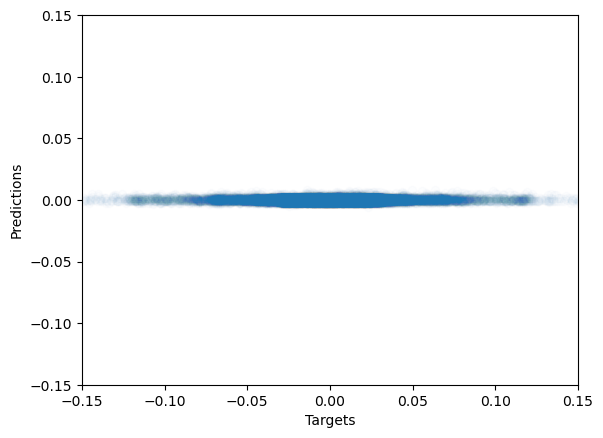

In [25]:
all_batches_fix = []
for i in all_batches:
    for j in i:
        all_batches_fix.append(j)

all_targets_x = [yuh[0] for yuh in all_batches_fix]
#print(all_batches)
print(len(all_targets_x))
all_predictions_x = [yuh[0] for yuh in all_predictions]
print(np.array(all_predictions).shape)
print(len(all_predictions_x))
plt.scatter(all_targets_x, all_predictions_x, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

42787
42787


Text(0, 0.5, 'Predictions')

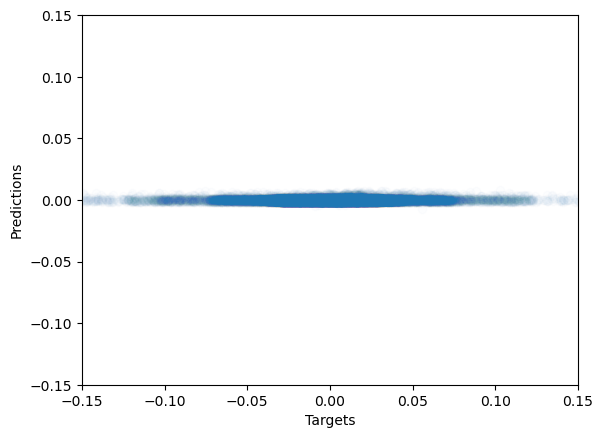

In [26]:
all_targets_y = [yuh[1] for yuh in all_batches_fix]
print(len(all_targets_y))
all_predictions_y = [yuh[1] for yuh in all_predictions]
print(len(all_predictions_y))
plt.scatter(all_targets_y, all_predictions_y, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

42787
42787


Text(0, 0.5, 'Predictions')

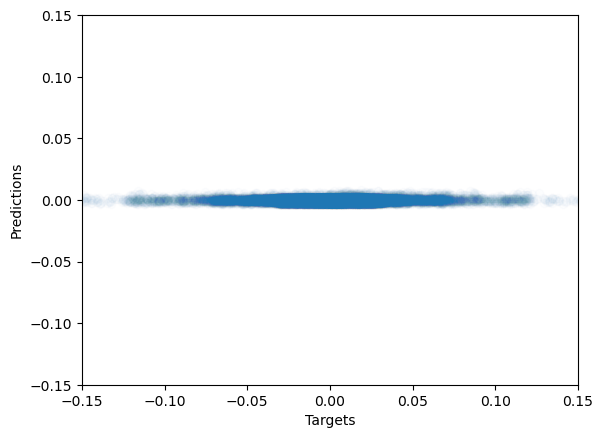

In [27]:
all_targets_z = [yuh[2] for yuh in all_batches_fix]
print(len(all_targets_z))
all_predictions_z = [yuh[2] for yuh in all_predictions]
print(len(all_predictions_z))
plt.scatter(all_targets_z, all_predictions_z, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [28]:
ball = get_sphere(3)
blankdataset = build_blank_dataset(ball, "softboi1")

testDataset = np.load("/Users/kevin/textureProject/GINR-texture/softboi1/npz_files/softboi1.npz")
xtestDataset = testDataset["fourier"]

predicts = model(torch.Tensor(xtestDataset).float())
predicts[:50]

tensor([[ 4.5400e-03,  4.5827e-03,  4.1823e-03],
        [ 2.9694e-03,  3.4706e-03,  4.4013e-03],
        [ 4.3852e-03,  3.5797e-03,  4.1956e-03],
        [-3.9011e-04,  7.8964e-04,  8.6427e-06],
        [ 1.6114e-03,  2.2186e-03,  2.0427e-03],
        [ 3.6456e-03,  3.8388e-03,  2.5594e-03],
        [ 1.6092e-03,  2.3922e-03,  3.8865e-03],
        [ 2.5332e-05,  1.1470e-03,  1.5722e-03],
        [ 2.3577e-03,  1.0223e-03,  7.9191e-04],
        [ 1.5080e-03,  4.2251e-03,  1.5574e-03],
        [ 3.9351e-04,  2.2175e-03,  1.1268e-03],
        [ 2.3750e-03,  1.4170e-03,  1.9209e-03],
        [-1.0395e-04,  9.2208e-05,  3.8880e-04],
        [-1.0395e-04,  9.2208e-05,  3.8880e-04],
        [-1.0395e-04,  9.2208e-05,  3.8880e-04],
        [-1.0395e-04,  9.2208e-05,  3.8880e-04],
        [-1.0395e-04,  9.2208e-05,  3.8880e-04],
        [-1.0395e-04,  9.2208e-05,  3.8880e-04],
        [-1.0395e-04,  9.2208e-05,  3.8880e-04],
        [-1.0395e-04,  9.2208e-05,  3.8880e-04],
        [-1.0395e-04

In [29]:
yuh = generate_pred_mesh(predicts.detach().numpy(), ball)
yuh.show()

40962


Text(0, 0.5, 'Predictions')

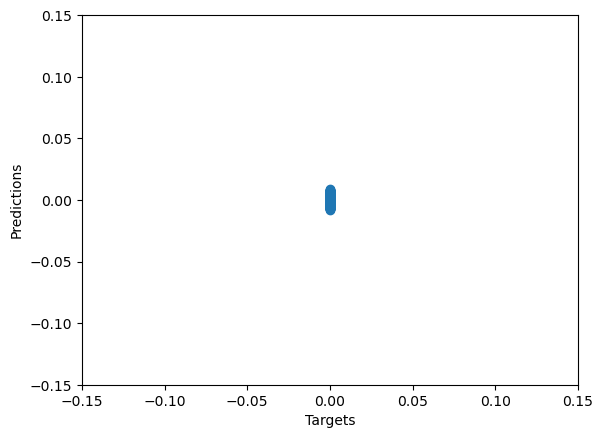

In [56]:
all_targets_x = testDataset["target"]
all_predictions_x = [yuh[0] for yuh in predicts.detach().numpy()]
print(len(all_predictions_x))
plt.scatter(all_targets_x, all_predictions_x)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [30]:
model2 = MLP(
    input_dim = traindatax.shape[1],
    output_dim = traindatay.shape[1],
    hidden_dim = 512,
    n_layers = 6,
    geometric_init = True,
    beta = True,
    sine=False,
    all_sine=False,
    skip=True,
    bn=True,
    dropout=0.0

)

In [31]:
trainingLoad = torch.utils.data.DataLoader(trainingDataset, batch_size = 1000, shuffle = True)

lossfunc = torch.nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), .0001)

In [32]:
all_predictions = []
all_batches = []

In [33]:
for i in range(100):
    for batch in trainingLoad:
        
        optimizer.zero_grad()
        
        Xbatch = batch[0]
        Ybatch = batch[1]
        
        #print(Ybatch)
        
        predicts = model2(Xbatch)
        #print(predicts)
        
        if i == 99:
            for a in predicts:
                print(a)
                all_predictions.append(a.detach().numpy())
                
            all_batches.append(Ybatch.detach().numpy())
        
        error = lossfunc(predicts, Ybatch)
        #print(predicts, Ybatch)
        print(error.detach().numpy())
        error.backward()
        
        optimizer.step()

1.0008339
0.99954665
1.0014122
0.9997463
1.0014036
1.0010911
1.0014094
1.0015094
1.0017188
1.0011657
1.0000812
1.0008205
1.0012113
1.0001225
1.0007149
1.0025034
0.99945533
1.0015787
1.002404
1.001323
1.0010045
1.0007849
1.0002302
0.9998021
1.0002016
1.0006412
0.99898064
1.0017986
0.99930364
0.99982774
1.0009987
1.0022976
1.0007071
1.0002545
0.9995436
1.0017728
1.0012249
1.0017883
1.0006098
1.0014244
1.0008382
1.0004151
1.002567
1.0019032
1.000892
1.0003746
1.0016092
1.001094
1.0014476
1.0015715
1.0004158
1.0027145
1.0009559
1.0013518
1.0005002
0.99957144
1.0001198
1.002218
1.0017366
1.0013081
1.0009621
0.9987077
1.0002915
0.99889517
1.0000516
1.0027976
1.0016534
1.0014671
1.0004752
1.0018933
1.0015334
1.0001048
1.0008043
1.0001472
1.002279
1.0004469
1.0001581
0.9993169
0.99896634
1.0003561
1.0008982
1.0019301
1.0024273
1.0009621
0.999295
0.9998953
1.0013431
0.9998345
1.0005994
1.0009043
1.001303
0.99922657
1.0025291
1.0001501
1.0019749
0.9993114
1.0012947
1.0004817
0.99972975
1.0019016

1.001525
0.999958
0.9994982
1.000677
1.0019414
0.99937433
1.0026141
1.001379
1.0002981
1.0005215
1.0013899
1.0006158
1.0003227
1.0006678
1.0007315
1.0020661
1.0022155
1.0010482
1.0016279
1.0014837
1.0004213
1.0015842
1.001728
0.99980223
1.0009693
1.0015205
1.0035145
0.999469
0.99959385
1.0013102
1.0002546
1.0005358
0.9993946
1.0008676
1.0026948
1.0006616
1.0001281
0.9997111
1.0008099
1.001064
1.0005764
1.0007869
1.0004585
1.000675
1.0027469
0.9998766
0.9993856
1.0024108
1.0022151
1.0013384
1.0009673
1.0028839
0.99934214
0.9995482
1.0006403
1.0013915
1.0000621
1.0005292
1.0019107
1.0003489
1.0003359
1.0009872
1.0033339
1.000704
0.99868023
1.0021728
1.0015968
1.0005815
1.0010896
1.0019667
0.99859893
1.0009134
1.0003436
1.0004733
0.9992317
1.0010824
0.9995952
1.000872
1.0018083
1.0011756
1.0012844
1.0021236
1.0002822
0.99955755
0.99993294
1.0014665
1.0016345
1.0010868
0.9997752
0.9986515
0.9996214
1.0018703
0.999239
1.0014799
1.0034707
1.00056
1.0018755
1.0006701
1.0001113
1.0003563
1.000

1.0014144
1.0002812
1.0029893
1.0005659
1.0008194
1.0024636
1.0010033
1.0025214
1.0013131
1.0016838
1.0020369
1.0009364
1.0006616
1.0006487
0.99956733
1.0022997
1.0001572
0.9998035
1.0008682
0.9999484
0.9990039
1.0004587
1.0003656
1.000348
0.9988437
1.0001532
1.0021762
1.0025297
1.0020236
1.0000517
1.001272
1.0017328
1.0012653
0.9996178
1.0010667
1.0013719
1.0000747
0.99890804
1.0000937
1.0001192
1.0017667
1.0022027
0.9991831
1.0015025
1.000268
1.0005022
1.0021274
1.0010928
1.0021392
1.0014975
1.0005188
1.0028976
1.0012983
1.0004231
0.99982685
0.9995877
1.0024381
0.99972606
1.0003643
1.0020765
1.0015941
0.9999929
1.0010177
0.999779
1.0009918
1.0012416
0.9996315
1.0004549
0.9997159
1.0017676
0.99976856
1.0009124
1.0016819
1.0007539
1.002528
1.0025395
1.0030245
1.001698
1.0012853
1.0025587
0.9996263
1.002094
0.9994936
1.0006149
1.0001048
0.99941236
1.0010949
1.0014025
0.99826694
1.0015327
1.0009931
1.0010434
0.9989923
0.99763906
1.0011326
1.0000547
1.0004007
1.0004376
1.0014745
0.9997055

1.0006732
1.000327
1.001168
0.9997235
1.0004749
0.99959886
1.0017389
1.0006763
1.0016533
1.0001733
0.9993126
1.0006082
1.001555
1.0016319
1.0017327
1.0010884
1.001381
1.0021608
1.0013978
1.0011188
1.001324
1.0011566
1.0015861
1.0005379
1.0010762
0.9998184
1.0006486
0.9995533
1.0012602
1.0008126
1.0019695
0.999465
1.003638
1.0004314
1.002442
1.0021465
1.000401
0.9998537
1.0020592
0.99920815
1.0007207
1.0013458
1.000786
1.0015639
1.0011171
1.0024668
0.99830544
0.9987741
1.0006869
1.0007602
1.0014367
1.001258
1.000433
0.9998036
1.002528
1.0009128
1.0018271
1.0007395
1.0002356
1.0003011
0.9986115
1.0017287
1.000848
1.0017056
1.0001442
1.0012493
0.99752855
1.000903
1.0007298
1.0020747
1.0017035
1.0011002
1.0006659
1.0015308
1.0008427
1.0006793
1.000465
0.99970037
1.0009313
1.0021589
1.0012339
1.0012211
1.000449
1.003053
0.99961925
1.0000302
1.0025293
1.0006641
0.99890876
1.0007217
0.9998184
1.0006851
0.99914175
0.9991862
1.0016534
1.0005213
1.0005385
1.0014182
1.0008405
1.0021456
1.0016985


0.9993716
0.9999937
1.0005009
1.0010588
1.0004628
1.0023139
1.0031768
0.99880016
1.001862
1.00044
1.002851
1.0003328
1.0017924
1.0007648
1.0007061
1.000366
1.0003681
1.0011513
1.0005105
1.0027217
1.0005097
1.0003425
1.0007948
1.0031228
0.99948835
1.001408
1.0014731
1.0009463
1.0000333
1.0008414
1.0020677
1.0008587
1.0009731
1.0008905
1.0006207
1.0020673
1.001611
1.0011739
1.0002607
1.0001626
0.9990386
1.0026362
1.0002553
1.0014583
1.0001075
0.99974
1.000386
0.99831
1.0009123
1.0009134
1.0010399
1.0026622
1.0014713
0.99966425
1.0015
1.0005553
1.0006695
1.0032986
0.99837327
1.0005362
1.0014349
1.0013206
1.0000525
1.0019724
1.0023428
0.99986815
0.9999489
1.0008456
1.0005727
0.9994404
1.0004791
1.0003496
1.0006043
1.0005326
1.0005742
1.0010546
0.99914825
1.0027362
1.0006174
0.99976325
1.0019971
1.0011878
1.0035522
1.0017809
1.0011752
1.0011723
1.000532
1.0021181
1.0009815
1.001389
1.0006148
1.00235
1.0018755
1.0007938
1.000287
1.0010167
0.9997755
0.998882
1.0019951
1.0003731
0.99993426
1.0

1.0012553
0.9990513
1.0005952
0.99998015
1.0012202
1.0013958
1.0002117
1.0015835
1.0026027
1.0009604
1.000607
1.0002759
1.0024619
1.000495
1.0003037
1.000381
1.0002817
0.9992133
1.0001893
1.0013719
1.0004667
1.0009747
1.0006074
1.0018762
0.998204
1.001735
1.0010189
0.9998269
0.9990602
1.0005386
1.0010056
1.0012366
1.0016042
1.0023105
1.0016632
1.0007391
1.0008014
1.0000643
1.0002028
1.0005809
1.0007635
1.0027299
1.0001616
1.0024813
1.0009907
1.0010331
0.9996468
0.99957126
1.0000951
1.0000486
1.001361
0.9998534
0.99997485
1.0009952
1.0018712
1.002115
1.0004156
1.0013402
1.0028698
1.0006381
1.0004059
1.0016141
1.0001678
1.0012321
1.0017848
0.9985871
1.001009
1.001628
1.0037955
1.0007151
1.0005307
1.0006679
1.0009577
1.0018159
0.999651
1.0000005
0.999491
1.000092
0.9993842
1.0009812
0.99919176
1.0028219
1.0004543
1.0022635
1.0006043
1.0000486
1.0020965
0.9999279
0.9996677
1.0005682
1.0005336
0.9994146
1.0019901
1.0007049
1.0013832
0.9994035
1.0003934
1.0016245
1.0030977
1.0014569
1.001643

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9997, -0.9997, -0.9998], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-1.0000, -0.9998, -1.0000], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-1.0001, -1.0001, -1.0002], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0000, -1.0002], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0000, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
0.99856013
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0004], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0002], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-1.0002, -1.0001, -0.9999], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-1.0005, -1.0002, -0.9995], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-1.0000, -0.9994, -1.0002], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-1.0002, -0.9998, -0.9997], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9998, -1.0000, -0.9998], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0000, -1.0004], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0004], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-1.0000, -0.9999, -0.9999], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9999, -1.0000, -1.0002], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0000, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-1.0000, -1.0001, -1.0000], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9998, -1.0004, -1.0002], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-1.0002, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9999, -1.0000, -1.0000], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0004], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9995, -0.9997, -0.9995], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9999, -0.9998, -1.0004], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9998, -1.0000, -0.9999], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9997, -1.0001, -1.0003], grad_fn=<UnbindBack

tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-1.0002, -0.9996, -1.0001], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBackward0>)
tensor([-0.9996, -1.0001, -1.0003], grad_fn=<UnbindBack

42787
(42787, 3)
42787


Text(0, 0.5, 'Predictions')

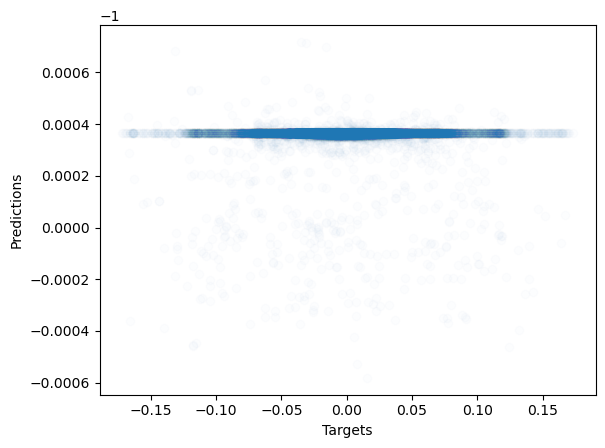

In [43]:
all_batches_fix = []
for i in all_batches:
    for j in i:
        all_batches_fix.append(j)

all_targets_x = [yuh[0] for yuh in all_batches_fix]
#print(all_batches)
print(len(all_targets_x))
all_predictions_x = [yuh[0] for yuh in all_predictions]
print(np.array(all_predictions).shape)
print(len(all_predictions_x))
plt.scatter(all_targets_x, all_predictions_x, alpha = 0.01)
#plt.xlim(-.15, .15)
#plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

42787
42787


Text(0, 0.5, 'Predictions')

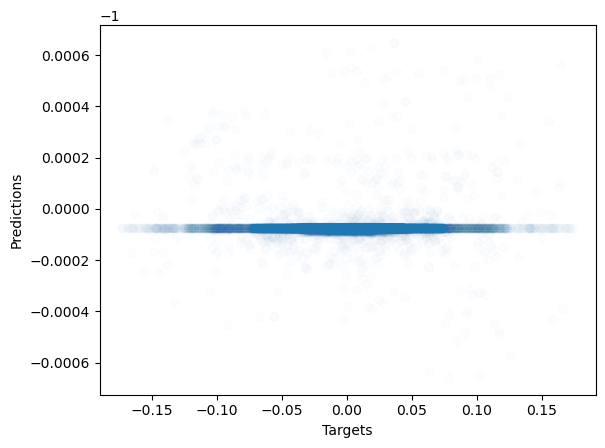

In [41]:
all_targets_y = [yuh[1] for yuh in all_batches_fix]
print(len(all_targets_y))
all_predictions_y = [yuh[1] for yuh in all_predictions]
print(len(all_predictions_y))
plt.scatter(all_targets_y, all_predictions_y, alpha = 0.01)
#plt.xlim(-.15, .15)
#plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

42787
42787


Text(0, 0.5, 'Predictions')

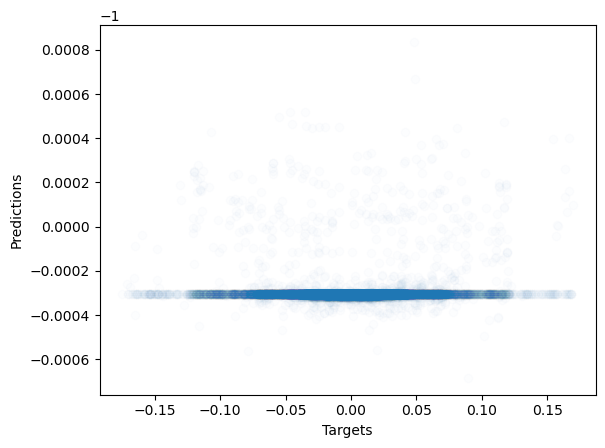

In [42]:
all_targets_z = [yuh[2] for yuh in all_batches_fix]
print(len(all_targets_z))
all_predictions_z = [yuh[2] for yuh in all_predictions]
print(len(all_predictions_z))
plt.scatter(all_targets_z, all_predictions_z, alpha = 0.01)
#plt.xlim(-.15, .15)
#plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [44]:
ball = get_sphere(3)
blankdataset = build_blank_dataset(ball, "softboi1")

testDataset = np.load("/Users/kevin/textureProject/GINR-texture/softboi1/npz_files/softboi1.npz")
xtestDataset = testDataset["fourier"]

predicts = model2(torch.Tensor(xtestDataset).float())
predicts[:50]

tensor([[-0.9997, -1.0003, -0.9999],
        [-1.0001, -1.0000, -1.0003],
        [-0.9999, -0.9998, -1.0000],
        [-1.0001, -0.9995, -1.0000],
        [-0.9998, -1.0003, -1.0000],
        [-1.0001, -0.9996, -0.9999],
        [-1.0001, -1.0001, -0.9998],
        [-1.0000, -1.0000, -0.9999],
        [-0.9997, -0.9997, -1.0003],
        [-0.9996, -0.9998, -1.0002],
        [-1.0003, -0.9999, -1.0003],
        [-1.0000, -0.9998, -0.9999],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
        [-0.9996, -1.0001, -1.0003],
 

In [45]:
yuh = generate_pred_mesh(predicts.detach().numpy(), ball)
yuh.show()

In [ ]:
all_targets_x = testDataset["target"]
all_predictions_x = [yuh[0] for yuh in predicts.detach().numpy()]
print(len(all_predictions_x))
plt.scatter(all_targets_x, all_predictions_x)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [46]:
mesh2 = trimesh.load('/Users/kevin/textureProject/GINR-texture/meshes/Spikeyball2.stl')
mesh2.show()

In [47]:
dataset2, smooth2 = build_offset_dataset(mesh2, smooth_iter = 20000, lap_type = 'mesh', smooth_type = 'taubin')
smooth2.show()

In [48]:
blankdataset = build_blank_dataset(smooth2, "spikeboi1")

In [49]:
traindatax2 = torch.Tensor(dataset2["fourier"]).float()
traindatay2 = torch.Tensor(dataset2["target"]).float()

In [50]:
model3 = MLP(
    input_dim = traindatax.shape[1],
    output_dim = traindatay.shape[1],
    hidden_dim = 512,
    n_layers = 6,
    geometric_init = True,
    beta = True,
    sine=True,
    all_sine=True,
    skip=True,
    bn=True,
    dropout=0.0

)

In [51]:
trainingDataset2 = torch.utils.data.TensorDataset(traindatax2, traindatay2)

In [52]:
trainingLoad2 = torch.utils.data.DataLoader(trainingDataset2, batch_size = 1000, shuffle = True)

lossfunc2 = torch.nn.MSELoss()
optimizer2 = torch.optim.Adam(model2.parameters(), .0001)

In [53]:
all_predictions = []
all_batches = []

In [54]:
for i in range(100):
    for batch in trainingLoad2:
        
        optimizer2.zero_grad()
        
        Xbatch = batch[0]
        Ybatch = batch[1]
        
        #print(Ybatch)
        
        predicts = model2(Xbatch)
        #print(predicts)
        
        if i == 99:
            for a in predicts:
                print(a)
                all_predictions.append(a.detach().numpy())
                
            all_batches.append(Ybatch.detach().numpy())
        
        error = lossfunc2(predicts, Ybatch)
        #print(predicts, Ybatch)
        print(error.detach().numpy())
        error.backward()
        
        optimizer2.step()

1.0019212
0.9113047
0.8126793
0.7213779
0.63043004
0.54081
0.46948063
0.39611283
0.33299977
0.26940447
0.2181298
0.1740549
0.13853405
0.09480536
0.07594682
0.05501335
0.036476977
0.025324896
0.018704256
0.01856346
0.011107837
0.009921854
0.016065707
0.017198278
0.020201426
0.024008874
0.023147605
0.029212672
0.025241802
0.027672201
0.016692124
0.013461039
0.010404929
0.0061138864
0.011364353
0.015061494
0.013688425
0.015348059
0.008986196
0.007876445
0.008428831
0.006375304
0.00485592
0.00582939
0.011386065
0.008455878
0.0076638376
0.028292162
0.00901091
0.0054921377
0.005109222
0.005972088
0.0042599402
0.0062889075
0.0031743112
0.007089904
0.0042290622
0.0050904043
0.003616675
0.006056721
0.0034312538
0.0029400238
0.006045836
0.0038606182
0.005925967
0.0034896724
0.0029967458
0.004694773
0.005035821
0.004578624
0.0044266903
0.0008916255
0.0028638477
0.0052425135
0.0056569623
0.003171071
0.002803167
0.0024643955
0.005574179
0.0033769251
0.0019254583
0.0029772285
0.0022542523
0.00252744

0.0013764213
0.001497207
0.0014605005
0.0013072342
0.0014646896
0.0013574489
0.0013558776
0.0012876913
0.0014566949
0.0012525241
0.0013109322
0.0013395748
0.0012176642
0.0012825556
0.0012946768
0.0014452251
0.001246769
0.0013203755
0.0013477238
0.0013581245
0.00139095
0.0013589798
0.0013549274
0.0012377832
0.001295721
0.0014354617
0.0012926394
0.0016601239
0.0013395075
0.0013024621
0.0012140445
0.0012375419
0.0012287684
0.0013391784
0.0014637059
0.001340316
0.0013968771
0.0014743458
0.0013511681
0.001321234
0.0014073787
0.0012932984
0.0011960559
0.0014325042
0.001438729
0.0012409843
0.0013382327
0.0013589304
0.0013760194
0.001435922
0.0012512528
0.0014136435
0.0011601142
0.0012448911
0.0012490113
0.0013860826
0.0014512074
0.0013130726
0.0014043977
0.0011601573
0.001314854
0.0014351555
0.0013277292
0.0013505185
0.0014162004
0.0013144007
0.0014605292
0.0012472721
0.0014399167
0.0011973026
0.0013897598
0.0013468723
0.0013621184
0.0013305877
0.0013079895
0.0013598726
0.0012572401
0.0012808

0.0014397623
0.0012673286
0.0011673282
0.0012861515
0.0013673779
0.0013181085
0.0014853248
0.0013043148
0.0014347074
0.0012823457
0.0012889617
0.0011943026
0.0011839228
0.0013606413
0.0012678002
0.00088478584
0.0013577789
0.001242217
0.001321955
0.0013822435
0.0010834349
0.0013626212
0.0014219102
0.0013722796
0.0012740289
0.0013203403
0.0013278937
0.0013099681
0.0013114542
0.0013403689
0.0012511578
0.0011922221
0.00124626
0.0013675395
0.0012897413
0.001176157
0.0014610334
0.0013193444
0.001540498
0.0010914295
0.0011725689
0.0014375784
0.0012740723
0.0013274297
0.0012505819
0.0012412954
0.0011736725
0.0013174757
0.0011354488
0.0012331369
0.001386961
0.0013492639
0.0014375119
0.0014203488
0.0012436898
0.001386075
0.0013076342
0.0013902906
0.0013375066
0.0014195098
0.0014391737
0.0012313093
0.0012945806
0.00127407
0.0012533617
0.0014077208
0.0013704392
0.0013344352
0.0013149842
0.0013558359
0.0012818358
0.0012317962
0.0012356696
0.0012759906
0.001265903
0.0012376102
0.0013177058
0.0011885

0.0014453074
0.0013685712
0.0012891296
0.0012874173
0.0011750447
0.0012515872
0.0012323519
0.00138286
0.0013791911
0.0013206078
0.0012098588
0.0012825263
0.001347691
0.0013317842
0.0012402678
0.0013072517
0.0015464643
0.0012456715
0.0012482216
0.0012229742
0.0012981262
0.00122783
0.0013007009
0.0013878274
0.0013460631
0.0016645595
0.0012237353
0.0013496884
0.0014792233
0.001213291
0.001417026
0.0011984872
0.0012703193
0.0012927472
0.0013279022
0.0013527249
0.001330921
0.001302937
0.0013061808
0.001246657
0.0012474844
0.001255829
0.0012692044
0.0012853971
0.0013212517
0.0013863128
0.0012541263
0.0012469837
0.001323203
0.0020444824
0.0011666986
0.0013547926
0.0012008845
0.0013239228
0.0013049544
0.0014012821
0.0014591223
0.0015598354
0.0013238273
0.001458553
0.0011703841
0.0013763582
0.0011238381
0.0012410525
0.0014215595
0.0011858926
0.0011202235
0.00128421
0.0014719348
0.0012947599
0.0012678008
0.001397872
0.0012586166
0.0021361455
0.0012940174
0.0013724783
0.0012559171
0.0012799886
0.

tensor([1.2162e-03, 2.5600e-05, 1.9040e-03], grad_fn=<UnbindBackward0>)
tensor([1.2167e-03, 2.6107e-05, 1.9045e-03], grad_fn=<UnbindBackward0>)
tensor([-0.0293, -0.0283, -0.0280], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2159e-03, 2.5302e-05, 1.9033e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2162e-03, 2.5555e-05, 1.9040e-03], grad_fn=<UnbindBackward0>)
tensor([0.0256, 0.0227, 0.0246], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2188e-03, 2.8312e-05, 1.9064e-03], grad_fn=<UnbindBackward0>)
tensor([1.214

tensor([1.2168e-03, 2.6092e-05, 1.9041e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2159e-03, 2.5138e-05, 1.9034e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2162e-03, 2.5377e-05, 1.9040e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBack

tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2177e-03, 2.7284e-05, 1.9049e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2190e-03, 2.7910e-05, 1.9058e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2190e-03, 2.8357e-05, 1.9065e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBackward0>)
tensor([1.2147e-03, 2.4259e-05, 1.9028e-03], grad_fn=<UnbindBack

tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 0.0013, -0.0025, -0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0054, 0.0019, 0.0041], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3049e-03, -3.8296e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2857e-03, -2.3019e-03, -3.5465e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2798e-03, -2.3072e-03, -4.0889e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2822e-03, -2.3051e-03, -3.8594e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2819e-03, -2.3056e-03, -3.9220e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2818e-03, -2.3053e-03, -3.8743e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2684e-03, -2.3193e-03, -5.2691e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad

tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([0.0067, 0.0034, 0.0058], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2827e-03, -2.3044e-03, -3.7879e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2824e-03, -2.3050e-03, -3.8415e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2824e-03, -2.3050e-03, -3.8415e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.3252e-03, -2.2575e-03,  1.4812e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2356e-03, -2.3379e-03, -9.3639e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2828e-03, -2.3044e-03, -3.771

tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2803e-03, -2.3066e-03, -4.0099e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2801e-03, -2.3076e-03, -4.1038e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 0.0016, -0.0020,  0.0002], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2823e-03, -2.3050e-03, -3.8460e-05], grad_fn=<UnbindBackward0>)
tensor([ 1.2830e-03, -2.3045e-03, -3.

tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0042, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0052, -0.0029], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBack

tensor([-0.0148, -0.0177, -0.0163], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0015, -0.0037, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBack

tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0045, -0.0046], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBack

tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0014, -0.0039, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0011, -0.0041, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0040, -0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0013, -0.0039, -0.0017], grad_fn=<UnbindBack

tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0572, 0.0526, 0.0507], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackwar

tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0044, -0.0026], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBack

tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBack

tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBack

tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0039, -0.0013,  0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0043, -0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0258, 0.0215, 0.0195], grad_fn=<UnbindBackwar

tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0023, -0.0021, -0.0013], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBack

tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0021, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([0.0049, 0.0005, 0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackwar

tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0060, -0.0080, -0.0074], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0021, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0018, -0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0022, -0.0014], grad_fn=<UnbindBack

tensor([ 0.0032,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0034, 0.0005, 0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0034, 0.0007, 0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0013, -0.0013], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>

tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0032,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0001], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBack

tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0001], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0032,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 3.3130e-03,  2.2635e-04, -9.6127e-05], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0517, -0.0507, -0.0558], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn

tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0033,  0.0002, -0.0002], grad_fn=<UnbindBackward0>)
tensor([ 0.0032,  0.0002, -0.0002], grad_fn=<UnbindBack

tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 1.4199e-03, -3.6210e-06, -1.4720e-03], grad_fn

tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBack

tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0021,  0.0008, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0022,  0.0010, -0.0004], grad_fn=<UnbindBack

tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([0.0897, 0.0846, 0.0861], grad_fn=<UnbindBackward0>)
tensor([-3.9414e-05,  8.4786e-04, -1.1556e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.7983e-05,  8.4943e-04, -1.1542e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.7119e-05,  8.5005e-04, -1.153

tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9488e-05,  8.4665e-04, -1.1564e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.8028e-05,  8.4898e-04, -1.1546e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4734e-04, -1.1560e-03], grad_fn=<UnbindBackward0>)
tensor([-1.8418e-05,  8.6606e-04, -1.1411e-03], grad_fn=<UnbindBackward0>)
tensor([-3.9861e-05,  8.4

tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0060, -0.0025, -0.0052], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBack

tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([0.0190, 0.0221, 0.0201], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.1136, -0.1124, -0.1148], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([0.0205, 0.0245, 0.0200], grad_fn=<UnbindBackward0>

tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBack

tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0021,  0.0009, -0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0023,  0.0007, -0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-7.0472e-04,  2.5463e-03, -9.0450e-06], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0006, -0.0018], grad_fn

tensor([-4.8254e-03,  1.5870e-05, -2.8189e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8234e-03,  1.8060e-05, -2.8170e-03], grad_fn=<UnbindBackward0>)
tensor([-2.4922e-03,  2.1336e-03,  6.6161e-06], grad_fn=<UnbindBackward0>)
tensor([-4.8215e-03,  2.0146e-05, -2.8150e-03], grad_fn=<UnbindBackward0>)
tensor([-0.0038,  0.0038, -0.0010], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8235e-03,  1.7762e-05, -2.

tensor([-4.8237e-03,  1.7375e-05, -2.8179e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8258e-03,  1.5438e-05, -2.8194e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8243e-03,  1.7434e-05, -2.8180e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8220e-03,  1.9282e-05, -2.8165e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8238e-03,  1.7717e-05, -2.8176e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8234e-03,  1.8016e-05, -2.8172e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7

tensor([-4.8236e-03,  1.7643e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8256e-03,  1.5676e-05, -2.8192e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8240e-03,  1.7285e-05, -2.8178e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7807e-05, -2.8172e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8226e-03,  1.8969e-05, -2.8165e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8255e-03,  1.6242e-05, -2.8190e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8249e-03,  1.6481e-05, -2.8187e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7762e-05, -2.8174e-03], grad_fn=<UnbindBackward0>)
tensor([-4.8236e-03,  1.7

tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0056, -0.0006, -0.0032], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBack

tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([0.0180, 0.0234, 0.0187], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0036,  0.0014, -0.0012], grad_fn=<UnbindBackwar

tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0009,  0.0022,  0.0022], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017,  0.0029,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBack

tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017,  0.0029,  0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0343, -0.0305, -0.0334], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0017,  0.0029,  0.0010], grad_fn=<UnbindBack

tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0018,  0.0029,  0.0009], grad_fn=<UnbindBack

tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-1.0297e-05,  3.1109e-03,  2.7618e-03], grad_fn=<UnbindBackward0>)
tensor([-0.0008,  0.0033,  0.0028], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9721e-06,  3.1133e-03,  2.7645e-03], grad_fn=<UnbindBackward0>)
tensor([-8.4043e-06,  3.1130e-03,  2.7644e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-9.5367e-06,  3.1119e-03,  2.

tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-8.2254e-06,  3.1133e-03,  2.7643e-03], grad_fn=<UnbindBackward0>)
tensor([-9.3579e-06,  3.1120e-03,  2.7632e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-1.1265e-05,  3.1099e-03,  2.7609e-03], grad_fn=<UnbindBackward0>)
tensor([-3.3975e-06,  3.1152e-03,  2.7632e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-1.1623e-05,  3.1108e-03,  2.7626e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-8.8960e-06,  3.1125e-03,  2.7636e-03], grad_fn=<UnbindBackward0>)
tensor([-0.1142, -0.1109, -0.1125], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.

tensor([-1.0699e-05,  3.1112e-03,  2.7617e-03], grad_fn=<UnbindBackward0>)
tensor([-1.1042e-05,  3.1105e-03,  2.7613e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.2569e-06,  3.1142e-03,  2.7652e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.3612e-06,  3.1142e-03,  2.7652e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9870e-06,  3.1134e-03,  2.7642e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.9125e-06,  3.1

tensor([-7.9125e-06,  3.1136e-03,  2.7646e-03], grad_fn=<UnbindBackward0>)
tensor([-7.8678e-06,  3.1137e-03,  2.7643e-03], grad_fn=<UnbindBackward0>)
tensor([-7.8678e-06,  3.1137e-03,  2.7643e-03], grad_fn=<UnbindBackward0>)
0.001238851
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0020, 0.0030], grad_fn=<UnbindBackward0>)
tensor([-0.0784, -0.0752, -0.0782], grad_fn=<UnbindBackward0>)
tensor([-0.0260, -0.0223, -0.0232], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0020, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0011, 0.0021, 0.0031], grad

tensor([0.0682, 0.0684, 0.0622], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0020, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0008, 0.0018, 0.0028], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([-0.0763, -0.0748, -0.0771], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0031], grad_fn=<UnbindBackward0>)
tensor([-0.0101, -0.0102, -0.0047], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], g

tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0031], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0031], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn

tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0007, 0.0007, 0.0023], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0010, 0.0021, 0.0030], grad_fn

tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBack

tensor([0.0272, 0.0241, 0.0261], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0013, -0.0007,  0.0017], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackwar

tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBack

tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([0.1070, 0.1068, 0.1057], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0012, -0.0008,  0.0020], grad_fn=<UnbindBackwar

tensor([ 0.0027, -0.0018,  0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([-0.0179, -0.0220, -0.0193], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBack

tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0025, -0.0021,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBack

tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBack

tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([0.0110, 0.0072, 0.0072], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([-0.0005, -0.0054, -0.0024], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0022,  0.0015], grad_fn=<UnbindBackwar

tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBack

tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 5.9123e-03, -1.0341e-05,  3.5661e-03], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0030, -0.0035,  0.0003], grad_fn

tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBack

tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBackward0>)
tensor([ 0.0032, -0.0033,  0.0004], grad_fn=<UnbindBack

tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([0.0381, 0.0330, 0.0337], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackwar

tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBack

tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0699, -0.0772, -0.0720], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0043, -0.0012], grad_fn=<UnbindBackward0>)
tensor([ 0.0030, -0.0039, -0.0008], grad_fn=<UnbindBack

tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0018, -0.0040, -0.0022], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBack

tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([-0.0068, -0.0108, -0.0106], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0047, -0.0031], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBack

tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBack

tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0021], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0039, -0.0020], grad_fn=<UnbindBackward0>)
0.0013098124
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0091, -0.0151, -0.0111], grad_f

tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0078, 0.0065, 0.0070], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackwar

tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBack

tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0039, -0.0120, -0.0139], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBackward0>)
tensor([ 0.0010, -0.0025, -0.0019], grad_fn=<UnbindBack

tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 6.3637e-04,  4.6194e-05, -8.4946e-04], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0008,  0.0003, -0.0006], grad_fn

tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([-0.0933, -0.0980, -0.0954], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBack

tensor([ 0.0006,  0.0055, -0.0031], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0002, -0.0007], grad_fn=<UnbindBack

tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn

tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0086, 0.0125, 0.0108], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0285, -0.0264, -0.0292], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0028, 0.0010], grad

tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBack

tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0085, -0.0020, -0.0054], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBack

tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0010,  0.0041,  0.0017], grad_fn=<UnbindBack

tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0045,  0.0020], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0236, 0.0298, 0.0273], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0024,  0.0044,  0.0019], grad_fn=<UnbindBackwar

23042
(23042, 3)
23042


Text(0, 0.5, 'Predictions')

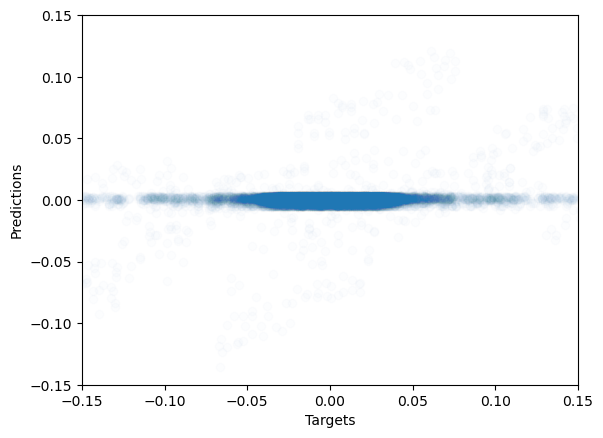

In [55]:
all_batches_fix = []
for i in all_batches:
    for j in i:
        all_batches_fix.append(j)

all_targets_x = [yuh[0] for yuh in all_batches_fix]
#print(all_batches)
print(len(all_targets_x))
all_predictions_x = [yuh[0] for yuh in all_predictions]
print(np.array(all_predictions).shape)
print(len(all_predictions_x))
plt.scatter(all_targets_x, all_predictions_x, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

23042
23042


Text(0, 0.5, 'Predictions')

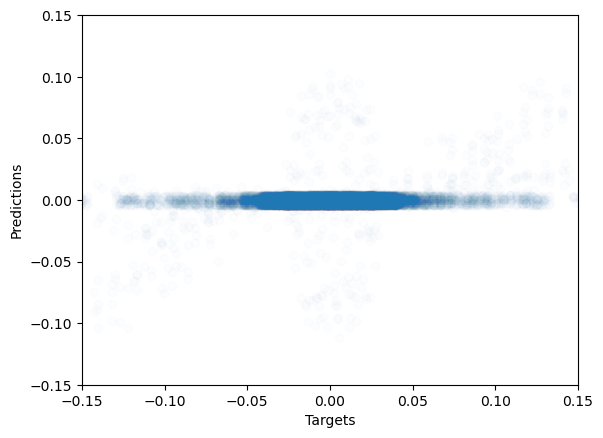

In [56]:
all_targets_y = [yuh[1] for yuh in all_batches_fix]
print(len(all_targets_y))
all_predictions_y = [yuh[1] for yuh in all_predictions]
print(len(all_predictions_y))
plt.scatter(all_targets_y, all_predictions_y, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

23042
23042


Text(0, 0.5, 'Predictions')

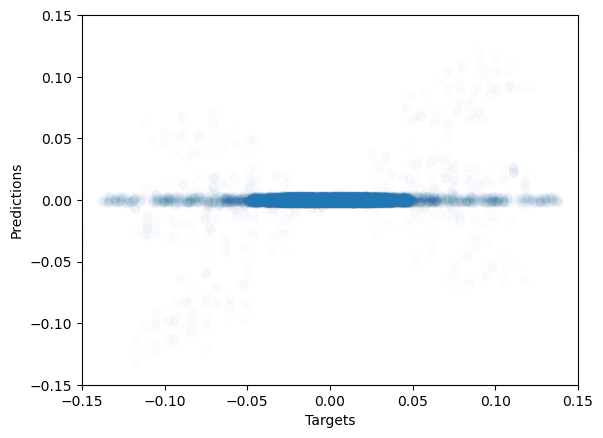

In [57]:
all_targets_z = [yuh[2] for yuh in all_batches_fix]
print(len(all_targets_z))
all_predictions_z = [yuh[2] for yuh in all_predictions]
print(len(all_predictions_z))
plt.scatter(all_targets_z, all_predictions_z, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [65]:
model4 = MLP(
    input_dim = traindatax.shape[1],
    output_dim = traindatay.shape[1],
    hidden_dim = 512,
    n_layers = 6,
    geometric_init = True,
    beta = True,
    sine=False,
    all_sine=False,
    skip=True,
    bn=True,
    dropout=0.0

)

In [66]:
trainingLoad2 = torch.utils.data.DataLoader(trainingDataset2, batch_size = 1000, shuffle = True)

lossfunc2 = torch.nn.MSELoss()
optimizer2 = torch.optim.Adam(model4.parameters(), .0001)

In [67]:
all_predictions = []
all_batches = []

In [68]:
for i in range(100):
    for batch in trainingLoad2:
        
        optimizer2.zero_grad()
        
        Xbatch = batch[0]
        Ybatch = batch[1]
        
        #print(Ybatch)
        
        predicts = model4(Xbatch)
        #print(predicts)
        
        if i == 99:
            for a in predicts:
                print(a)
                all_predictions.append(a.detach().numpy())
                
            all_batches.append(Ybatch.detach().numpy())
        
        error = lossfunc2(predicts, Ybatch)
        #print(predicts, Ybatch)
        print(error.detach().numpy())
        error.backward()
        
        optimizer2.step()

1.0020012
0.9128841
0.81450367
0.7190149
0.62909037
0.5437141
0.4682378
0.39586374
0.334004
0.27222624
0.22251976
0.18116927
0.1378744
0.1090398
0.08014291
0.054523524
0.04045613
0.029633354
0.018184002
0.012968052
0.013218675
0.010578277
0.016489275
0.015329762
0.024478773
0.021768909
0.025242541
0.024879865
0.025238106
0.026890878
0.022945551
0.016410932
0.010788687
0.0065992447
0.010318605
0.010891103
0.012142487
0.011307184
0.008240724
0.012764885
0.010347246
0.0061561684
0.0095519265
0.010024955
0.0046245633
0.008453041
0.00840493
0.004719662
0.0064416677
0.0044651157
0.0044007814
0.007924177
0.0071461396
0.0045597027
0.0035749788
0.0050959806
0.0055379486
0.0068377852
0.005180523
0.0035196343
0.0046037
0.0025484243
0.0056544845
0.0060975035
0.0047982605
0.004697205
0.0027571952
0.0035930204
0.0056419466
0.004597412
0.0026204383
0.0010209326
0.0044376967
0.0044534993
0.0031836121
0.002659997
0.00324369
0.003966946
0.0025378654
0.0028640798
0.0034677945
0.0029061222
0.0030846004
0.

0.0013005036
0.0014680894
0.001228812
0.0014337328
0.0013096853
0.0007686688
0.001244988
0.001191761
0.0012933243
0.0012586619
0.001423147
0.0014287517
0.0011775182
0.001365944
0.001465104
0.0013419829
0.0014809201
0.001593236
0.001235282
0.00139141
0.0012665284
0.0012828178
0.0012115494
0.0013104135
0.0013699435
0.0014273268
0.0014135768
0.0014000835
0.0012584612
0.001445665
0.0012916886
0.0014260199
0.0013728717
0.0012972234
0.0011797054
0.0014293699
0.0015516911
0.0012735652
0.0013243903
0.0014597044
0.0013377757
0.0013434858
0.001311568
0.001461107
0.0013975707
0.0012294038
0.0012575636
0.0013645291
0.0014127393
0.001346007
0.0012310256
0.0012071317
0.0012481433
0.0012308848
0.001462374
0.0012999849
0.0014891707
0.0013301576
0.0012036768
0.0013407003
0.0013432724
0.0013707662
0.0012526548
0.0012631092
0.001467193
0.0013397879
0.0013395029
0.001218573
0.0012762642
0.0012982105
0.0013483022
0.0013754559
0.0012570543
0.0015190996
0.0013180675
0.0013870237
0.0012661236
0.0011114121
0.0

0.0014213099
0.0011690689
0.0012414672
0.001387044
0.0013136106
0.0012558895
0.0013603343
0.0014236416
0.0012481249
0.0012345834
0.0014286082
0.001454415
0.0011549614
0.0012667547
0.0012626073
0.0015256571
0.0013873376
0.0013487339
0.0012629027
0.001310358
0.0013381073
0.0013525222
0.0012792774
0.0012930388
0.0013174361
0.0012652575
0.0013549881
0.0014093376
0.0013794434
0.0012425866
0.0013251195
0.0011420393
0.0013455527
0.0013701558
0.0013086707
0.001252617
0.0013477831
0.0012835588
0.0013400264
0.00075045205
0.0012936796
0.0011331618
0.0012273666
0.0012278277
0.0013482914
0.0012849142
0.0011449526
0.0013082662
0.0012756508
0.0013234864
0.001314503
0.0012453631
0.0013743421
0.0012690189
0.0011930558
0.0012708738
0.0014563086
0.0014034365
0.0014509645
0.0014915189
0.0014982455
0.0013352825
0.0012451679
0.00090555125
0.0011614105
0.0013653806
0.0013368448
0.001227569
0.0013293563
0.001268011
0.001350564
0.0011827206
0.001346684
0.0013265813
0.0013220956
0.001402881
0.0014438011
0.00140

0.0012812378
0.0010857236
0.0012141226
0.0012616538
0.001231639
0.001391874
0.0012380091
0.0012775593
0.0011792192
0.0013406265
0.0013476223
0.0011566385
0.001347722
0.0012926593
0.0013679488
0.0012195586
0.0013701215
0.0012492782
0.0012556461
0.0014121825
0.0012545998
0.0013336731
0.0013371728
0.0013592178
0.0014318081
0.0009554619
0.0013091237
0.0013360808
0.0013115073
0.0013566174
0.0012560972
0.0011623227
0.0011888115
0.001167294
0.0012328716
0.001305356
0.0012653127
0.0012616699
0.0012110439
0.0014290808
0.0015716762
0.0014112061
0.0013683521
0.001278511
0.0013430301
0.0012084595
0.0012303636
0.0013223562
0.0012999532
0.001488543
0.001264329
0.0012727701
0.0013816134
0.0012264343
0.0013694407
0.0011646013
0.0012713133
0.0014087259
0.001348407
0.0013663961
0.0012263857
0.0013080206
0.0012047588
0.0011610655
0.0012086524
0.0011417449
0.0013767469
0.001262972
0.0012779424
0.0014257615
0.0013841386
0.0012717483
0.001450964
0.0017492985
0.001201862
0.001253136
0.0012894034
0.001309572


tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBack

tensor([-0.0461, -0.0434, -0.0420], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0019, -0.0009,  0.0012], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBack

tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0041, 0.0053, 0.0061], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0022, -0.0012,  0.0009], grad_fn=<UnbindBackwar

tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0061, 0.0036, 0.0075], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackwar

tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBack

tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0104, 0.0073, 0.0119], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0025, -0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackwar

tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([0.1061, 0.1053, 0.1036], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([0.0294, 0.0281, 0.0303], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>

tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0014, -0.0018,  0.0004], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBackward0>)
tensor([-0.0023, -0.0024, -0.0002], grad_fn=<UnbindBack

tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBack

tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0007, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([0.0141, 0.0149, 0.0184], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackwar

tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0576, -0.0607, -0.0660], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBack

tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([0.0799, 0.0777, 0.0786], grad_fn=<UnbindBackward0>)
tensor([0.0464, 0.0444, 0.0471], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([0.0246, 0.0247, 0.0279], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
t

tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-7.8464e-04, -2.2396e-03,  8.6784e-05], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([0.0275, 0.0212, 0.0277], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
tensor([-0.0008, -0.0022,  0.0001], grad_fn=<UnbindBackward0>)
0.0012173186
tensor([ 0.0017, -0.0006,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011

tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0006,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0006,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0006,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBack

tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0006,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0006,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0019, -0.0005,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0006,  0.0011], grad_fn=<UnbindBack

tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0006,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0007,  0.0011], grad_fn=<UnbindBack

tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([-0.0001, -0.0029, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBack

tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0004,  0.0010], grad_fn=<UnbindBack

tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([0.0209, 0.0196, 0.0185], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0027, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0003,  0.0011], grad_fn=<UnbindBackwar

tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBack

tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBack

tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBack

tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([0.0057, 0.0026, 0.0032], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0022, -0.0007,  0.0003], grad_fn=<UnbindBackwar

tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([-0.0021, -0.0048, -0.0041], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0015, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBack

tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0009], grad_fn=<UnbindBackward0>)
tensor([ 0.0017, -0.0005,  0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBack

tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBack

tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBack

tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0008, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0014, -0.0010], grad_fn=<UnbindBack

tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([-0.0087, -0.0139, -0.0131], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0014, -0.0003, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBack

tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0004, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBack

tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0013, -0.0014], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([-0.0905, -0.0943, -0.0877], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0003, -0.0014, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0004, -0.0014, -0.0015], grad_fn=<UnbindBack

tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([0.0141, 0.0138, 0.0126], grad_fn=<UnbindBackward0>)
tensor([-0.0019, -0.0014, -0.0032], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackwar

tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0007,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0005, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBack

tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0007], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([0.1081, 0.1062, 0.1060], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0006,  0.0004, -0.0006], grad_fn=<UnbindBackwar

tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0013, 0.0029, 0.0007], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0037, 0.0050, 0.0028], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.1007, -0.0970, -0.1031], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0040, 0.0025, 0.0012], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad

tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0016, 0.0033, 0.0010], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn

tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0800, 0.0793, 0.0792], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0014, 0.0031, 0.0009], grad_fn

tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.4915e-05,  3.2754e-03,  2.6512e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.5034e-05,  3.2748e-03,  2.6512e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.5034e-05,  3.2750e-03,  2.6488e-04], grad_fn=<UnbindBackward0>)
tensor([-2.5630e-05,  3.2748e-03,  2.6464e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2

tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.5392e-05,  3.2752e-03,  2.6512e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.5153e-05,  3.2746e-03,  2.6500e-04], grad_fn=<UnbindBackward0>)
tensor([-2.4796e-05,  3.2750e-03,  2.6512e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2

tensor([-0.0001,  0.0032,  0.0002], grad_fn=<UnbindBackward0>)
tensor([-2.4796e-05,  3.2728e-03,  2.6274e-04], grad_fn=<UnbindBackward0>)
tensor([-2.2888e-05,  3.2771e-03,  2.6703e-04], grad_fn=<UnbindBackward0>)
tensor([7.6175e-05, 3.3729e-03, 3.6287e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.5749e-05,  3.2752e-03,  2.6464e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([0.0447, 0.0473, 0.0450], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn=<UnbindBackward0>)
tensor([-2.6822e-05,  3.2730e-03,  2.6345e-04], grad_fn

tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0099, -0.0044, -0.0078], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0029,  0.0012, -0.0013], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBack

tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([0.0663, 0.0693, 0.0638], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackwar

tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0014, -0.0014], grad_fn=<UnbindBackward0>)
tensor([0.0390, 0.0446, 0.0416], grad_fn=<UnbindBackward0>)
tensor([-0.0031,  0.0015, -0.0014], grad_fn=<UnbindBackwar

tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBack

tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBack

tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0401, -0.0339, -0.0397], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0124, -0.0069, -0.0105], grad_fn=<UnbindBack

tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBackward0>)
tensor([-0.0052, -0.0003, -0.0025], grad_fn=<UnbindBack

tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0003, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0041,  0.0002, -0.0014], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBack

tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0034,  0.0009, -0.0003], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0003, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBack

tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0041,  0.0002, -0.0009], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0039,  0.0004, -0.0008], grad_fn=<UnbindBack

tensor([-0.0006,  0.0015,  0.0017], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-2.4347e-03,  5.7745e-04,  7.9393e-05], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0114, 0.0151, 0.0106], grad_fn=<UnbindBackward0>)
tensor([0.0001, 0.0022, 0.0024], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<Unbi

tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBack

tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBackward0>)
tensor([-0.0006,  0.0015,  0.0016], grad_fn=<UnbindBack

tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0072, 0.0076, 0.0084], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn

tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn

tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0721, 0.0703, 0.0736], grad_fn=<UnbindBackward0>)
tensor([0.0020, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0022, 0.0031], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn

tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0020, 0.0021, 0.0029], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn=<UnbindBackward0>)
tensor([0.0021, 0.0021, 0.0030], grad_fn

tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0010, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0008, 0.0021], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn

tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0011, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn

tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn

tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn=<UnbindBackward0>)
tensor([0.0028, 0.0009, 0.0024], grad_fn

tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBack

tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBack

tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([-0.0467, -0.0481, -0.0500], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0027, -0.0006], grad_fn=<UnbindBack

tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0800, -0.0831, -0.0860], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0020], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0041, -0.0071, -0.0046], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBack

tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBack

tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBack

tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0893, -0.0952, -0.0919], grad_fn=<UnbindBackward0>)
tensor([-0.0007, -0.0050, -0.0023], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBackward0>)
tensor([-0.0003, -0.0045, -0.0019], grad_fn=<UnbindBack

tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBack

tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBack

tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0005, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBack

tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0009, -0.0032, -0.0015], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([ 0.0006, -0.0035, -0.0018], grad_fn=<UnbindBackward0>)
tensor([-0.0244, -0.0263, -0.0264], grad_fn=<UnbindBack

tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0027, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0027, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0027, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBack

tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0027, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([0.0051, 0.0046, 0.0029], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0027, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackwar

tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([0.0186, 0.0148, 0.0146], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0024, -0.0014, -0.0005], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackward0>)
tensor([ 0.0026, -0.0011, -0.0003], grad_fn=<UnbindBackwar

tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0050, 0.0026, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0034, 0.0009, 0.0009], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0502, 0.0462, 0.0460], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn

tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0445, 0.0414, 0.0428], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn

tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0038, 0.0013, 0.0012], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0045, 0.0019, 0.0019], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn=<UnbindBackward0>)
tensor([0.0042, 0.0017, 0.0016], grad_fn

tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn

tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0562, 0.0549, 0.0531], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn

tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0036, 0.0033, 0.0023], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn=<UnbindBackward0>)
tensor([0.0029, 0.0024, 0.0013], grad_fn

tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBackward0>)
tensor([-0.0007,  0.0008, -0.0008], grad_fn=<UnbindBack

23042
(23042, 3)
23042


Text(0, 0.5, 'Predictions')

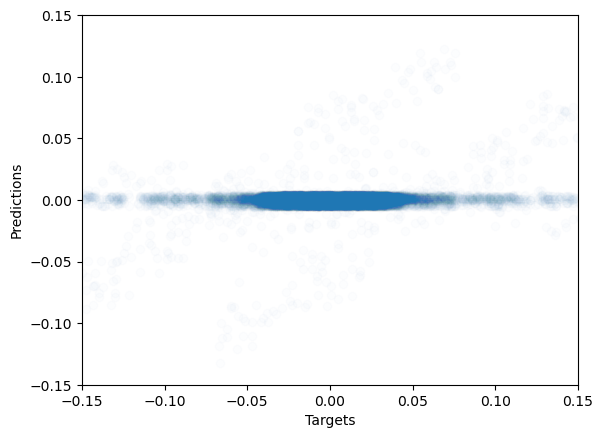

In [69]:
all_batches_fix = []
for i in all_batches:
    for j in i:
        all_batches_fix.append(j)

all_targets_x = [yuh[0] for yuh in all_batches_fix]
#print(all_batches)
print(len(all_targets_x))
all_predictions_x = [yuh[0] for yuh in all_predictions]
print(np.array(all_predictions).shape)
print(len(all_predictions_x))
plt.scatter(all_targets_x, all_predictions_x, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

23042
23042


Text(0, 0.5, 'Predictions')

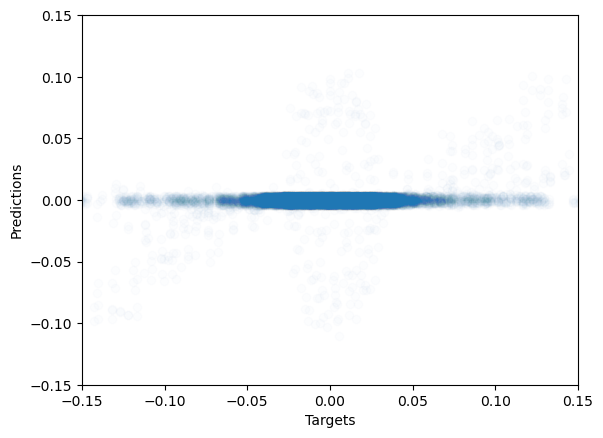

In [70]:
all_targets_y = [yuh[1] for yuh in all_batches_fix]
print(len(all_targets_y))
all_predictions_y = [yuh[1] for yuh in all_predictions]
print(len(all_predictions_y))
plt.scatter(all_targets_y, all_predictions_y, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

23042
23042


Text(0, 0.5, 'Predictions')

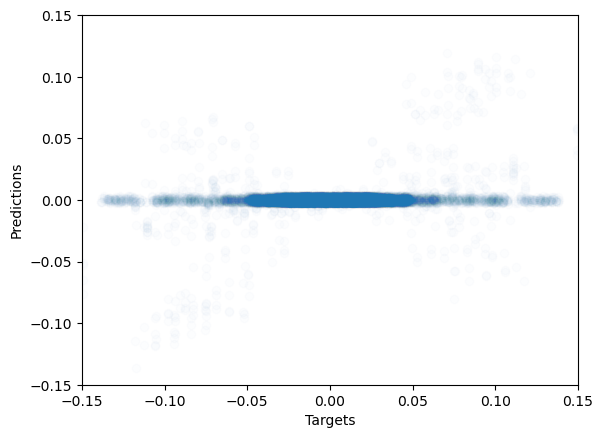

In [71]:
all_targets_z = [yuh[2] for yuh in all_batches_fix]
print(len(all_targets_z))
all_predictions_z = [yuh[2] for yuh in all_predictions]
print(len(all_predictions_z))
plt.scatter(all_targets_z, all_predictions_z, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")